In [19]:
def get_iou_vector(A,B):
    batch_size = A.shape[0]
    metric = 0.0
    for i in range(batch_size):
        t,p = A[i],B[i]
        #print(t.dtype)
        p = tf.dtypes.cast(p, tf.float32)
        intersection = np.sum(t * p)
        true = np.sum(t)
        pred = np.sum(p)
        
        if(true == 0):
            metric += (pred == 0)
            
        union = true + pred - intersection
        iou = intersection / union
        iou = np.floor(max(0,(iou - 0.45) * 20)) / 10
        metric += iou
    return metric / batch_size
def iou_metric(label,pred):
    return tf.py_function(get_iou_vector,[label,pred > 0.5],tf.float64)

In [20]:
def dice_coeff(y_true,y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.cast(K.greater(K.flatten(y_pred),0.5),'float32')
    intersection = K.sum(y_true_f * y_pred_f)
    dice_coeff = (intersection * 2) / (K.sum(y_true_f) + K.sum(y_pred_f))
    return dice_coeff

def dice_loss(y_true,y_pred):   
    smooth = 1
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    dice_coeff = (intersection * 2 + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return 1 - dice_coeff

def bce_dice_loss(y_true,y_pred):
    return binary_crossentropy(y_true,y_pred) + dice_loss(y_true,y_pred)

def bce_logdice_loss(y_true,y_pred):
    return binary_crossentropy(y_true,y_pred) - K.log(1. - dice_loss(y_true,y_pred))

In [21]:
from keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard
filepath = "/kaggle/working/best.h5"
checkpoint_1 = ModelCheckpoint(filepath,
monitor="val_iou_metric",
mode="max",
save_best_only=True,
verbose=1)
tensorboard_1 = TensorBoard(log_dir='graph_one', batch_size=16,update_freq='epoch')
callbacks_1 = [checkpoint_1,tensorboard_1]

In [22]:
model.compile(loss=bce_dice_loss, optimizer='SGD', metrics=[iou_metric])

In [23]:
# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please ensure you have installed TensorFlow correctly')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 2.3.1
Default GPU Device: /device:GPU:0


In [24]:
train_filepath = train_df['file_names'].tolist()
val_filepath = val_df['file_names'].tolist()
train_im_path = 'train_256'
train_mask_path = 'masks_256'
epochs = 30
batch_size = 16
train_generator = DataGenerator(filepath = train_filepath, augmentations=train_augment, batch_size = batch_size)
val_generator = DataGenerator(filepath = val_filepath, augmentations=train_augment, batch_size = batch_size)
history = model.fit_generator(train_generator,validation_data = val_generator,epochs = epochs,callbacks = callbacks_1)

Epoch 1/30
  3/640 [..............................] - ETA: 2:58 - loss: 1.7513 - iou_metric: 0.0000e+00

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in greater


 66/640 [==>...........................] - ETA: 2:51 - loss: 1.2501 - iou_metric: 9.4697e-04

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in float_scalars
  app.launch_new_instance()


640/640 [==============================] - ETA: 0s - loss: 1.0530 - iou_metric: 0.6782
Epoch 00001: val_iou_metric improved from -inf to 0.78153, saving model to /kaggle/working/best.h5
640/640 [==============================] - 227s 355ms/step - loss: 1.0530 - iou_metric: 0.6782 - val_loss: 1.0222 - val_iou_metric: 0.7815
Epoch 2/30
640/640 [==============================] - ETA: 0s - loss: 1.0185 - iou_metric: 0.7808
Epoch 00002: val_iou_metric did not improve from 0.78153
640/640 [==============================] - 158s 246ms/step - loss: 1.0185 - iou_metric: 0.7808 - val_loss: 1.0180 - val_iou_metric: 0.7793
Epoch 3/30
640/640 [==============================] - ETA: 0s - loss: 1.0156 - iou_metric: 0.7803
Epoch 00003: val_iou_metric did not improve from 0.78153
640/640 [==============================] - 159s 248ms/step - loss: 1.0156 - iou_metric: 0.7803 - val_loss: 1.0138 - val_iou_metric: 0.7793
Epoch 4/30
640/640 [==============================] - ETA: 0s - loss: 1.0096 - iou_metr

317

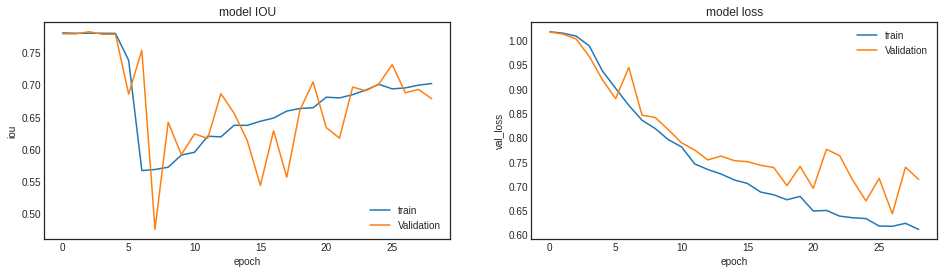

In [25]:
plt.figure(figsize=(16,4))
plt.subplot(1,2,1)
plt.plot(history.history['iou_metric'][1:])
plt.plot(history.history['val_iou_metric'][1:])
plt.ylabel('iou')
plt.xlabel('epoch')
plt.legend(['train','Validation'], loc='lower right')

plt.title('model IOU')
plt.savefig('iou.png')

plt.subplot(1,2,2)
plt.plot(history.history['loss'][1:])
plt.plot(history.history['val_loss'][1:])
plt.ylabel('val_loss')
plt.xlabel('epoch')
plt.legend(['train','Validation'], loc='upper right')
plt.title('model loss')
plt.savefig('loss.png')
gc.collect()

In [26]:
def predict_result(model,validation_generator,img_size): 
    # TBD predict both orginal and reflect x
    preds_test1 = model.predict_generator(validation_generator).reshape(-1, img_size, img_size)
    return preds_test1

In [27]:
val_augment_flipped = Compose([
    HorizontalFlip(),
    ToFloat()
])
val_augment = Compose([
    ToFloat()
])
validation_generator = DataGenerator(filepath = val_filepath, augmentations=val_augment, batch_size = batch_size, shuffle = False)
validation_generator_flipped = DataGenerator(filepath = val_filepath, augmentations=val_augment_flipped, batch_size = batch_size,  shuffle = False)
val_preds_flipped = predict_result(model,validation_generator_flipped, img_size)
val_preds = predict_result(model,validation_generator, img_size)
val_preds = 0.5 * val_preds_flipped + 0.5 * val_preds

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in greater


Text(0.5, 0.98, 'Green:Prediction , Red: Pneumothorax.')

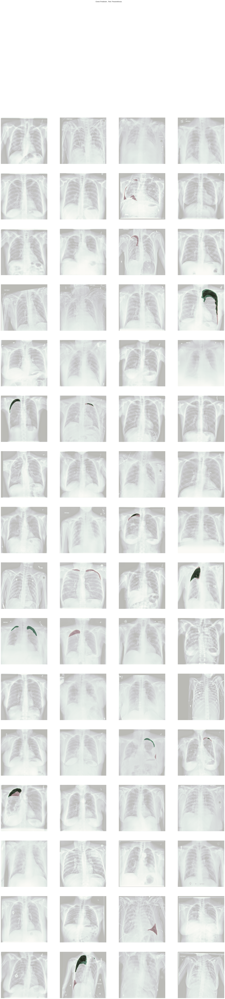

In [28]:
threshold_best = 0.5
max_images = 64
grid_width = 4
grid_height = int(max_images / grid_width)
fig, axs = plt.subplots(grid_height, grid_width, figsize=(grid_width*8, grid_height*8))

validation_generator = DataGenerator(filepath = val_filepath, augmentations=val_augment, batch_size = 64, shuffle = False)

images,masks = validation_generator.__getitem__(0)
for i,(im, mask) in enumerate(zip(images,masks)):
    pred = val_preds[i]
    ax = axs[int(i / grid_width), i % grid_width]
    ax.imshow(im[...,0], cmap="bone")
    ax.imshow(mask.squeeze(), alpha=0.5, cmap="Reds")    
    ax.imshow(np.array(np.round(pred > threshold_best), dtype=np.float32), alpha=0.5, cmap="Greens")
    ax.axis('off')
plt.suptitle("Green:Prediction , Red: Pneumothorax.")

In [29]:
def iou_metric(y_true_in, y_pred_in, print_table=False):
    labels = y_true_in
    y_pred = y_pred_in
    
    true_objects = 2
    pred_objects = 2 

    intersection = np.histogram2d(labels.flatten(), y_pred.flatten(), bins=(true_objects, pred_objects))[0]

    # Compute areas (needed for finding the union between all objects)
    area_true = np.histogram(labels, bins = true_objects)[0]
    area_pred = np.histogram(y_pred, bins = pred_objects)[0]
    area_true = np.expand_dims(area_true, -1)
    area_pred = np.expand_dims(area_pred, 0)

    # Compute union
    union = area_true + area_pred - intersection

    # Exclude background from the analysis
    intersection = intersection[1:,1:]
    union = union[1:,1:]
    union[union == 0] = 1e-9

    # Compute the intersection over union
    iou = intersection / union

    # Precision helper function
    def precision_at(threshold, iou):
        matches = iou > threshold
        true_positives = np.sum(matches, axis=1) == 1   # Correct objects
        false_positives = np.sum(matches, axis=0) == 0  # Missed objects
        false_negatives = np.sum(matches, axis=1) == 0  # Extra objects
        tp, fp, fn = np.sum(true_positives), np.sum(false_positives), np.sum(false_negatives)
        return tp, fp, fn

    # Loop over IoU thresholds
    prec = []
    if print_table:
        print("Thresh\tTP\tFP\tFN\tPrec.")
    for t in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = precision_at(t, iou)
        if (tp + fp + fn) > 0:
            p = tp / (tp + fp + fn)
        else:
            p = 0
        if print_table:
            print("{:1.3f}\t{}\t{}\t{}\t{:1.3f}".format(t, tp, fp, fn, p))
        prec.append(p)
    
    if print_table:
        print("AP\t-\t-\t-\t{:1.3f}".format(np.mean(prec)))
    return np.mean(prec)

def iou_metric_batch(y_true_in, y_pred_in):
    batch_size = y_true_in.shape[0]
    metric = []
    for batch in range(batch_size):
        value = iou_metric(y_true_in[batch], y_pred_in[batch])
        metric.append(value)
    return np.mean(metric)

#valid_fn = glob.glob('./keras_mask_val/*')
y_valid_ori = np.array([cv2.resize(np.array(Image.open(fn)),(img_size,img_size)) for fn in val_filepath])
assert y_valid_ori.shape == val_preds.shape

In [30]:
thresholds = np.linspace(0.2, 0.9, 31)
ious = np.array([iou_metric_batch(y_valid_ori, np.int32(val_preds > threshold)) for threshold in tqdm_notebook(thresholds)])

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


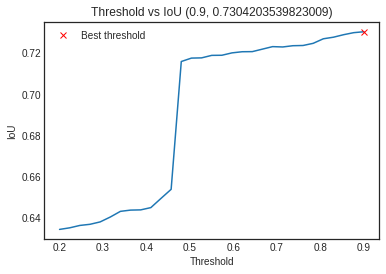

In [31]:
threshold_best_index = np.argmax(ious) 
iou_best = ious[threshold_best_index]
threshold_best = thresholds[threshold_best_index]

plt.plot(thresholds, ious)
plt.plot(threshold_best, iou_best, "xr", label="Best threshold")
plt.xlabel("Threshold")
plt.ylabel("IoU")
plt.title("Threshold vs IoU ({}, {})".format(threshold_best, iou_best))
plt.legend()

Text(0.5, 0.98, 'Green:Prediction , Red: Pneumothorax.')

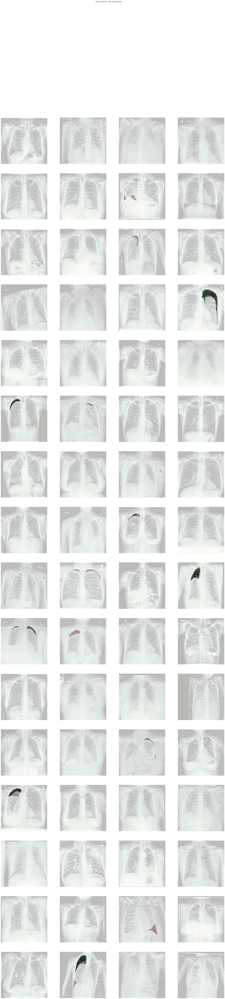

In [32]:
max_images = 64
grid_width = 4
grid_height = int(max_images / grid_width)
fig, axs = plt.subplots(grid_height, grid_width, figsize=(grid_width*8, grid_height*8))

validation_generator = DataGenerator(filepath = val_filepath, augmentations=val_augment, batch_size = 64, shuffle = False)

images,masks = validation_generator.__getitem__(0)
for i,(im, mask) in enumerate(zip(images,masks)):
    pred = val_preds[i]
    ax = axs[int(i / grid_width), i % grid_width]
    ax.imshow(im[...,0], cmap="bone")
    ax.imshow(mask.squeeze(), alpha=0.5, cmap="Reds")    
    ax.imshow(np.array(np.round(pred > threshold_best), dtype=np.float32), alpha=0.5, cmap="Greens")
    ax.axis('off')
plt.suptitle("Green:Prediction , Red: Pneumothorax.")

In [33]:
test_fn = glob.glob('../input/siim-og-test/*')
x_test = [cv2.resize(np.array(Image.open(fn)),(img_size,img_size)) for fn in test_fn]
x_test = np.array(x_test)
x_test = np.array([np.repeat(im[...,None],3,2) for im in x_test])
print(x_test.shape)
preds_test = model.predict(x_test,batch_size=batch_size)

(1377, 256, 256, 3)


In [34]:
def mask2rle(img, width, height):
    rle = []
    lastColor = 0;
    currentPixel = 0;
    runStart = -1;
    runLength = 0;

    for x in range(width):
        for y in range(height):
            currentColor = img[x][y]
            if currentColor != lastColor:
                if currentColor == 255:
                    runStart = currentPixel;
                    runLength = 1;
                else:
                    rle.append(str(runStart));
                    rle.append(str(runLength));
                    runStart = -1;
                    runLength = 0;
                    currentPixel = 0;
            elif runStart > -1:
                runLength += 1
            lastColor = currentColor;
            currentPixel+=1;

    return " ".join(rle)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:13: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  del sys.path[0]


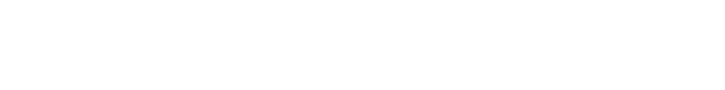

In [35]:
#from mask_functions import rle2mask,mask2rle
import pdb

# Generate rle encodings (images are first converted to the original size)
threshold_best = 0.5
max_images = 64
grid_width = 16
grid_height = int(max_images / grid_width)

rles = []
i,max_img = 1,10
plt.figure(figsize=(16,4))
for p in tqdm_notebook(preds_test):
    p = p.squeeze()
    im = cv2.resize(p,(1024,1024))
    im = im > threshold_best
#     zero out the smaller regions.
    if im.sum()<1024*2:
        im[:] = 0
    im = (im.T*255).astype(np.uint8)  
    rles.append(mask2rle(im,1024,1024))
    i += 1
    if i<max_img:
        plt.subplot(1,max_img,i)
        plt.imshow(im)
        plt.axis('off')

In [36]:
ids = [o.split('/')[-1][:-4] for o in test_fn]
sub_df = pd.DataFrame({'ImageId': ids, 'EncodedPixels': rles})
sub_df.loc[sub_df.EncodedPixels=='', 'EncodedPixels'] = '-1'
sub_df.head()

,ImageId,EncodedPixels
0,1.2.276.0.7230010.3.1.4.8323329.6989.151787520...,-1
1,1.2.276.0.7230010.3.1.4.8323329.6424.151787519...,-1
2,1.2.276.0.7230010.3.1.4.8323329.6015.151787519...,-1
3,1.2.276.0.7230010.3.1.4.8323329.6293.151787519...,-1
4,1.2.276.0.7230010.3.1.4.8323329.6139.151787519...,-1


In [37]:
sub_df.head()

,ImageId,EncodedPixels
0,1.2.276.0.7230010.3.1.4.8323329.6989.151787520...,-1
1,1.2.276.0.7230010.3.1.4.8323329.6424.151787519...,-1
2,1.2.276.0.7230010.3.1.4.8323329.6015.151787519...,-1
3,1.2.276.0.7230010.3.1.4.8323329.6293.151787519...,-1
4,1.2.276.0.7230010.3.1.4.8323329.6139.151787519...,-1


In [38]:
sub_df.tail()

,ImageId,EncodedPixels
1372,1.2.276.0.7230010.3.1.4.8323329.6284.151787519...,-1
1373,1.2.276.0.7230010.3.1.4.8323329.6517.151787519...,-1
1374,1.2.276.0.7230010.3.1.4.8323329.6574.151787519...,-1
1375,1.2.276.0.7230010.3.1.4.8323329.6102.151787519...,-1
1376,1.2.276.0.7230010.3.1.4.8323329.6911.151787520...,-1


In [39]:
sub_df.to_csv('result_2.csv')